<a href="https://colab.research.google.com/github/Tripti-Patel/LearningAndWorkingAI/blob/main/GoogleColab/CV_Assignment.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from utils import show_rgb_image, show_binary_image, sample_gaussian, zero_cross
from scipy.io import loadmat
from skimage.measure import label as skimage_label
from skimage.metrics import (adapted_rand_error, contingency_table,
                              variation_of_information)
from skimage.segmentation import join_segmentations
from sklearn.cluster import KMeans
from skimage.filters import threshold_otsu
import warnings
warnings.filterwarnings("ignore")
import cv2

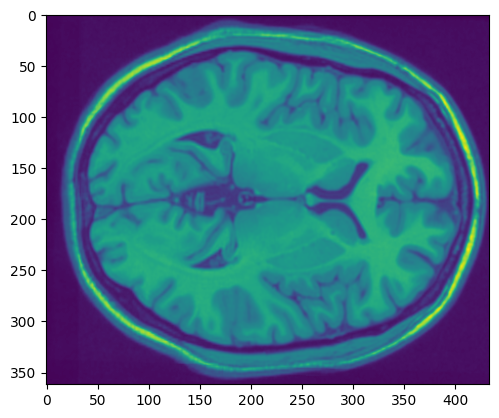

In [3]:
data = loadmat('Brain.mat')
T1 = data['T1']
label = data['label']

plt.imshow(T1[:, :, 0])

In [4]:
def evaluate_segmentation(segmented_image, ground_truth):
    # Calculate evaluation metrics
    # Example: Dice coefficient
    intersection = np.logical_and(segmented_image, ground_truth)
    dice_coefficient = 2.0 * intersection.sum() / (segmented_image.sum() + ground_truth.sum())
    return dice_coefficient

def eval_matrix(segmented_image, label_img):
    # Assuming seg_result and ground_truth are arrays representing the segmented results and ground truth labels, respectively

    # Calculate True Positives (TP), False Positives (FP), and False Negatives (FN)
    TP = np.sum(segmented_image & label_img)
    FP = np.sum(segmented_image & (~label_img))
    FN = np.sum((~segmented_image) & label_img)
    TN = np.sum((~segmented_image) & label_img)

    # Calculate Dice coefficient
    dice_coefficient = 2 * TP / (2 * TP + FP + FN)

    # Calculate Jaccard index
    jaccard_index = TP / (TP + FP + FN)

    # Calculate pixel accuracy
    pixel_accuracy = (TP + TN) / (TP + FP + TN + FN)

    # Print the calculated metrics
    print("Dice coefficient:", dice_coefficient)
    print("Jaccard index:", jaccard_index)
    print("Pixel accuracy:", pixel_accuracy)

def show_compared_images(t1_image, label_image, segmented_image, text):
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 15))
    # Plot Original T1 Image
    img1 = ax1.imshow(t1_image)
    fig.colorbar(img1, ax=ax1, location='bottom',pad=0.01)
    ax1.set_title('Original T1 Image', fontsize=15)
    ax1.axis('off')

    # Plot Label Image with Colorbar
    img2 = ax2.imshow(label_image)
    fig.colorbar(img2, ax=ax2, location='bottom',pad=0.01)
    ax2.set_title('Label Image', fontsize=15)
    ax2.axis('off')

    # Plot Segmented Image
    img3 = ax3.imshow(segmented_image)
    fig.colorbar(img3, ax=ax3, location='bottom', pad=0.01)
    #text = str(n_cluster)
    ax3.set_title(text, fontsize=15)
    ax3.axis('off')

    plt.show()



In [5]:
# Cluserting Based: K-Mean segmentation
def kmeans_segmentation(image, n_clusters=5):
    image = cv2.normalize(image, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)
    reshaped_image = np.reshape(image, (-1, 1))

    #X_normalised = (reshaped_image - np.mean(reshaped_image))/np.std(reshaped_image)
    #print(image)
    kmeans = KMeans(n_clusters=n_clusters, random_state=0, max_iter = 50, n_init=10).fit(reshaped_image)
    segmented_image = np.reshape(kmeans.labels_, image.shape)
    return segmented_image

def process_images_k_mean(n_cluster):
    for i in range(10):
        segmented_image = kmeans_segmentation(T1[:,:,i], n_cluster)
        show_compared_images(T1[:,:,i], label[:,:,i], segmented_image, 'K-Mean ' + str(n_cluster )+ ' Cluster')
        print('Level  '+ str(i) + ' Image')
        eval_matrix(segmented_image, label[:,:,i])
        #print(evaluate_segmentation(segmented_image, label[:,:,i]))

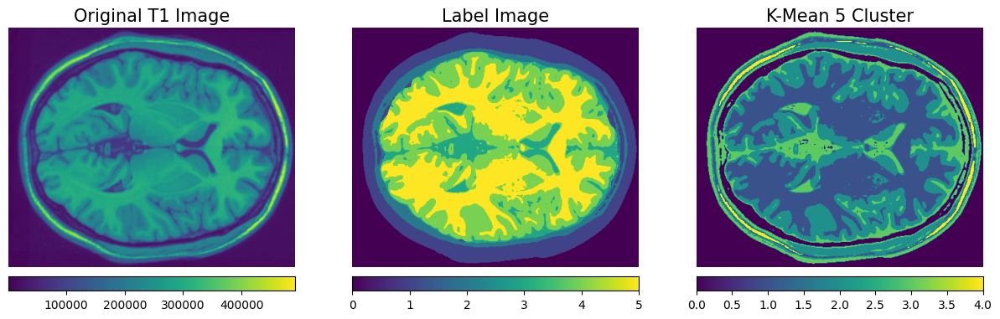

Level  0 Image
Dice coefficient: 0.25771737194287886
Jaccard index: 0.14791938333809151
Pixel accuracy: 0.47295776832534914


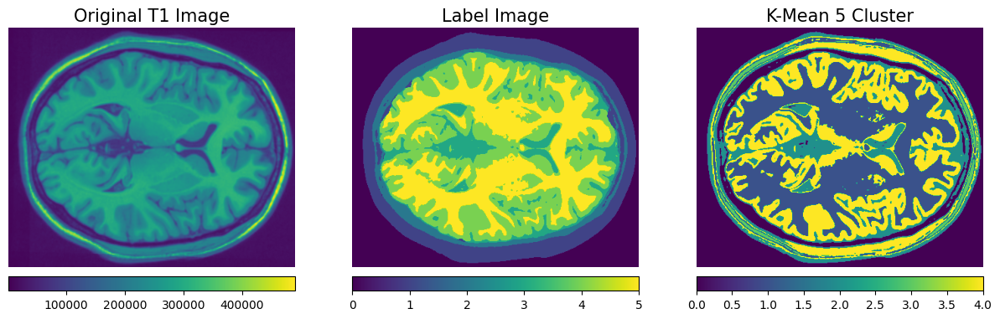

Level  1 Image
Dice coefficient: 0.5921082911559277
Jaccard index: 0.420563802909294
Pixel accuracy: 0.5953618885057141


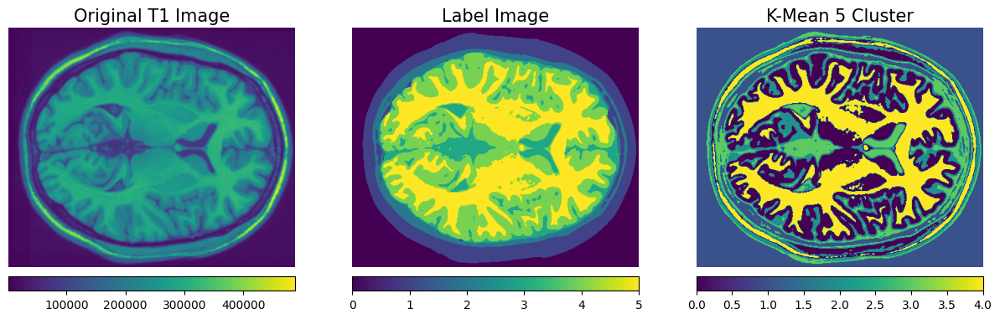

Level  2 Image
Dice coefficient: 0.4522818535766089
Jaccard index: 0.2922249471725735
Pixel accuracy: 0.5217776166200968


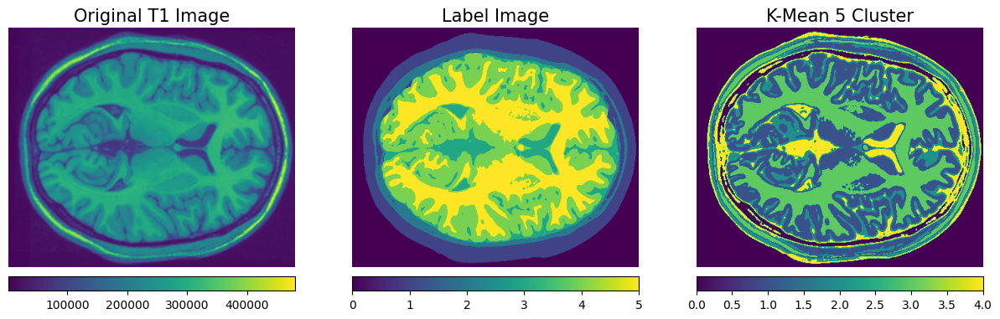

Level  3 Image
Dice coefficient: 0.15953759424116545
Jaccard index: 0.08668343006734065
Pixel accuracy: 0.4237139494523479


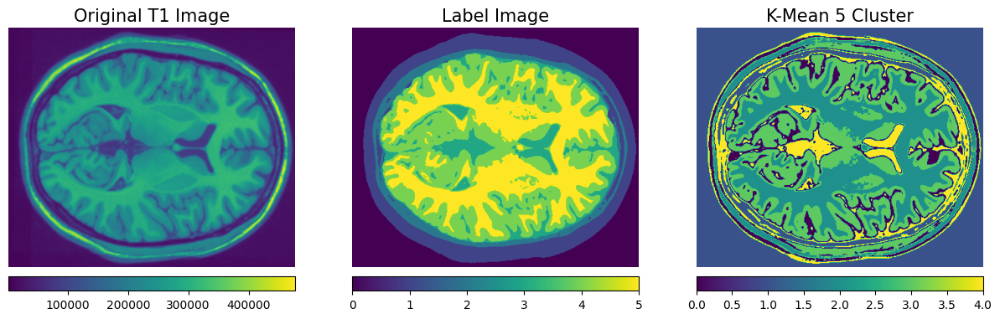

Level  4 Image
Dice coefficient: 0.030101452400142968
Jaccard index: 0.01528071201271703
Pixel accuracy: 0.3672616496523182


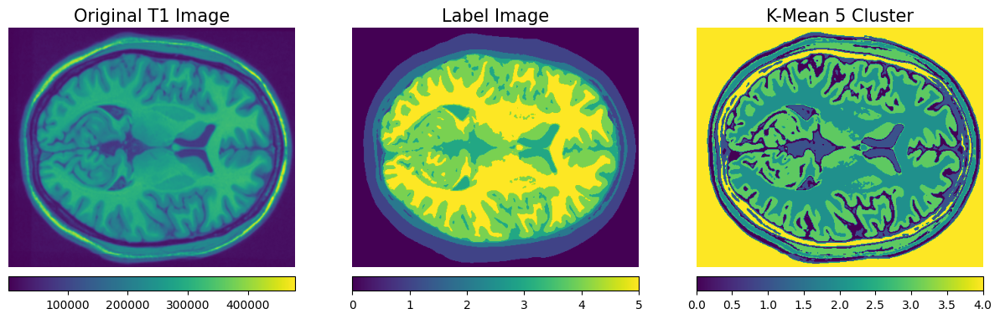

Level  5 Image
Dice coefficient: 0.054313866248229155
Jaccard index: 0.027915019440210742
Pixel accuracy: 0.3431337248194804


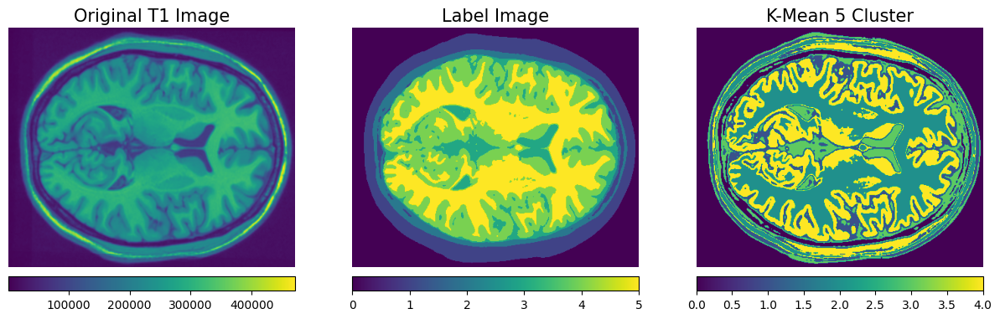

Level  6 Image
Dice coefficient: 0.5083813765503964
Jaccard index: 0.3408253078623303
Pixel accuracy: 0.5376914538171732


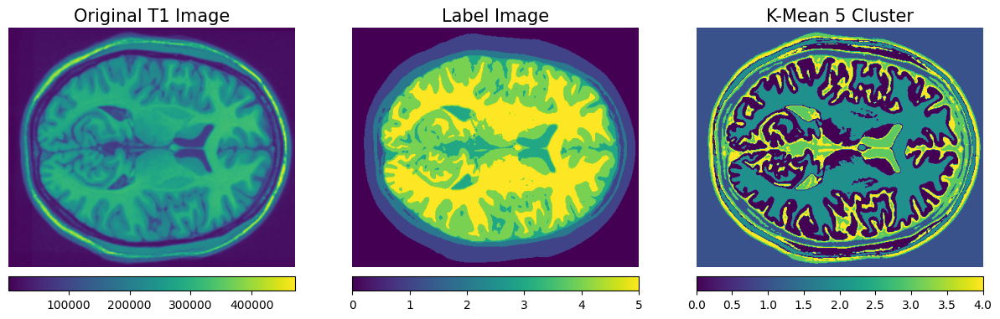

Level  7 Image
Dice coefficient: 0.20456689218629548
Jaccard index: 0.11393735099125815
Pixel accuracy: 0.4374779903744571


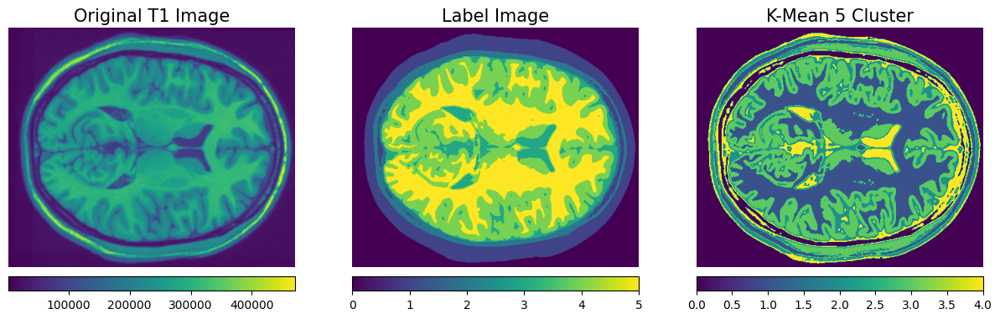

Level  8 Image
Dice coefficient: 0.16311737377953014
Jaccard index: 0.08880119581464872
Pixel accuracy: 0.4207979064186511


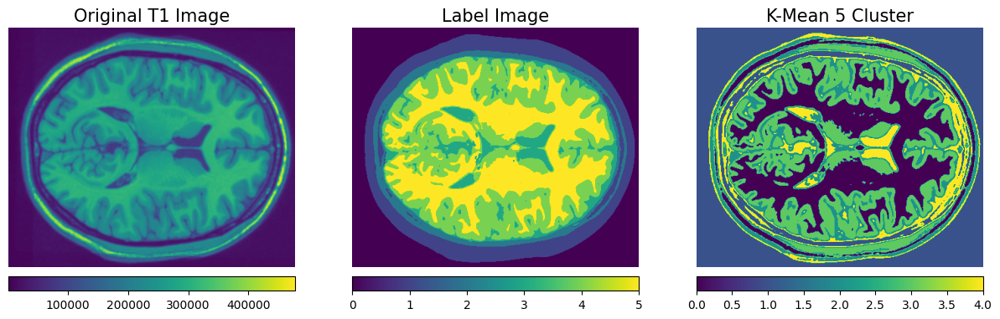

Level  9 Image
Dice coefficient: 0.05403124980753715
Jaccard index: 0.027765733546437105
Pixel accuracy: 0.38658397049455956


In [6]:
process_images_k_mean(5)

In [7]:
#threshold based: Otsu Method
def otsu_segmentation(image):
    threshold_value = threshold_otsu(image)
    segmented_image = image > threshold_value
    return segmented_image

def process_images_otsu():
    for i in range(10):
        segmented_image = otsu_segmentation(T1[:,:,i])
        show_compared_images(T1[:,:,i], label[:,:,i], segmented_image, 'Otsu Method')
        print('Level  '+ str(i) + ' Image')
        eval_matrix(segmented_image, label[:,:,i])
        #print(evaluate_segmentation(segmented_image, label[:,:,i]))


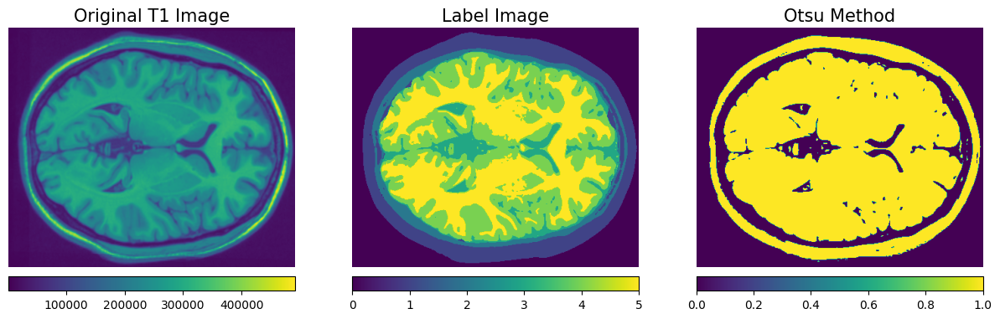

Level  0 Image
Dice coefficient: 0.6800213410094794
Jaccard index: 0.5151760116557785
Pixel accuracy: 0.570559094125973


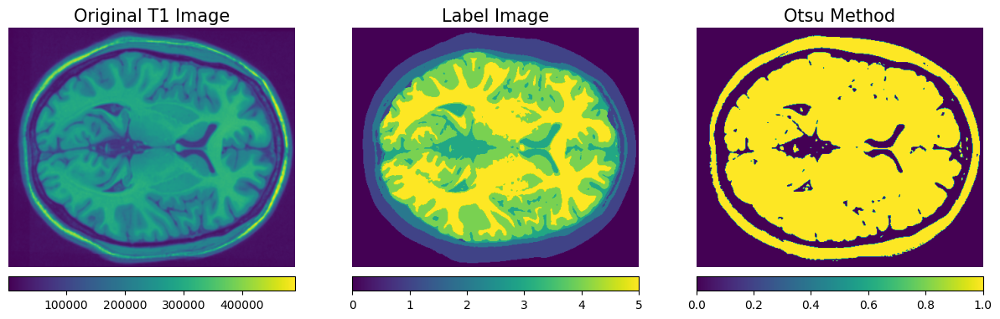

Level  1 Image
Dice coefficient: 0.6699499364023134
Jaccard index: 0.5037027964121504
Pixel accuracy: 0.5628666982016747


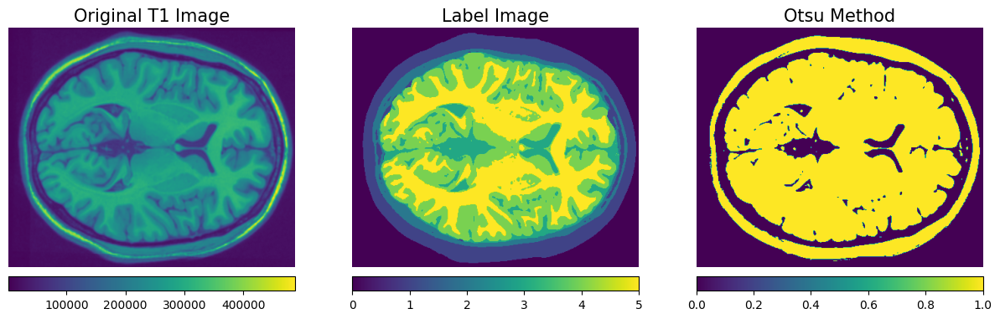

Level  2 Image
Dice coefficient: 0.6614407369446659
Jaccard index: 0.49414378219974475
Pixel accuracy: 0.5550899597592205


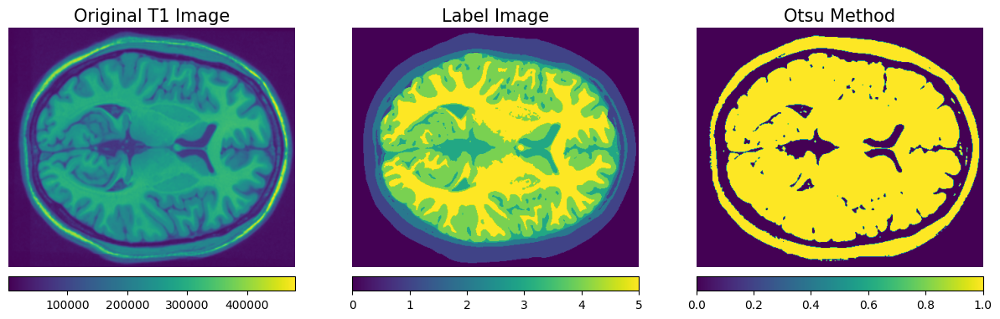

Level  3 Image
Dice coefficient: 0.6543237405946776
Jaccard index: 0.4862415726081358
Pixel accuracy: 0.5484791744684392


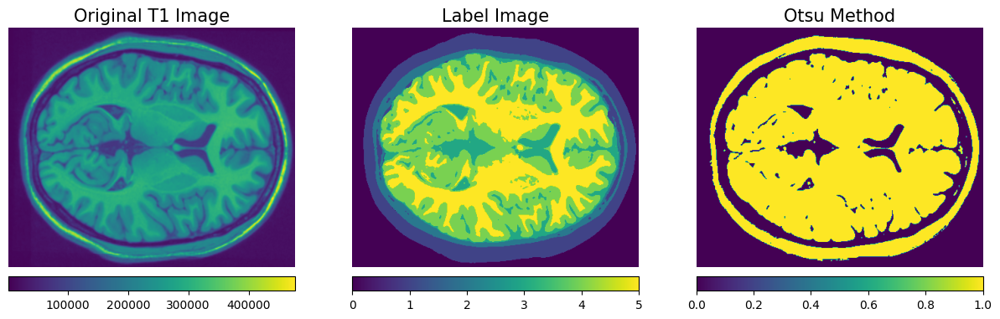

Level  4 Image
Dice coefficient: 0.6515168003482336
Jaccard index: 0.4831478809053623
Pixel accuracy: 0.5465608289326825


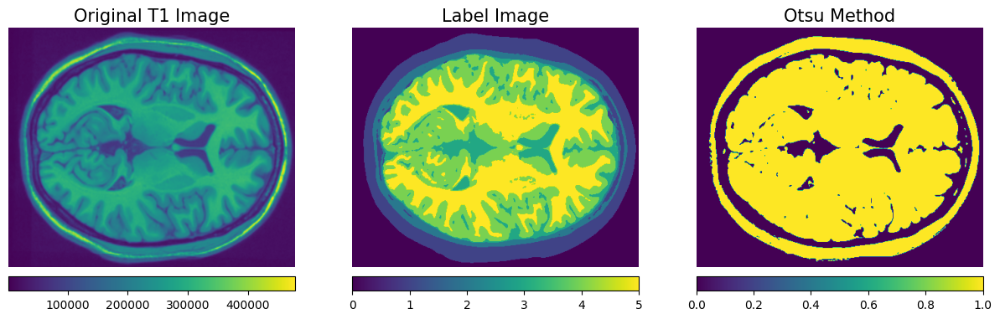

Level  5 Image
Dice coefficient: 0.6586588504249762
Jaccard index: 0.4910449892882647
Pixel accuracy: 0.5517643309965451


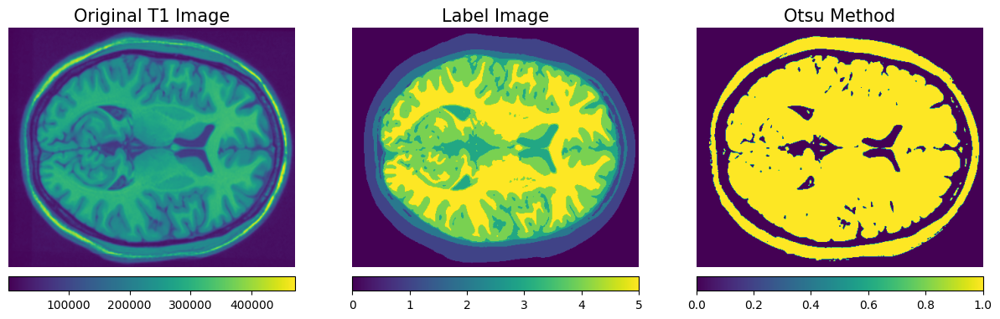

Level  6 Image
Dice coefficient: 0.6637251208438959
Jaccard index: 0.49669804558704067
Pixel accuracy: 0.5584630089207862


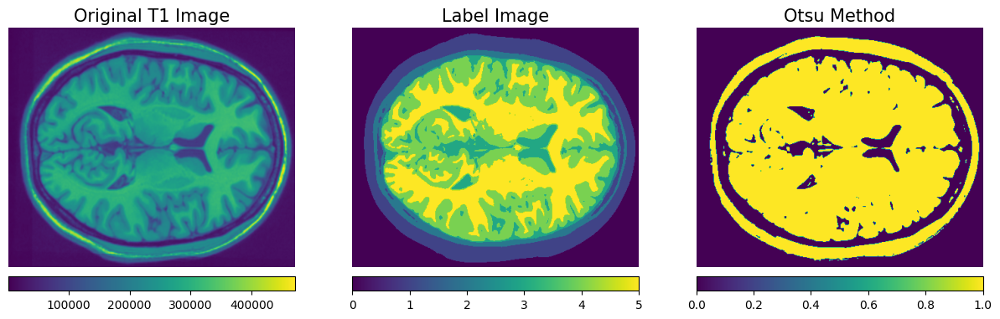

Level  7 Image
Dice coefficient: 0.662724170664751
Jaccard index: 0.4955777679719126
Pixel accuracy: 0.5571687228935955


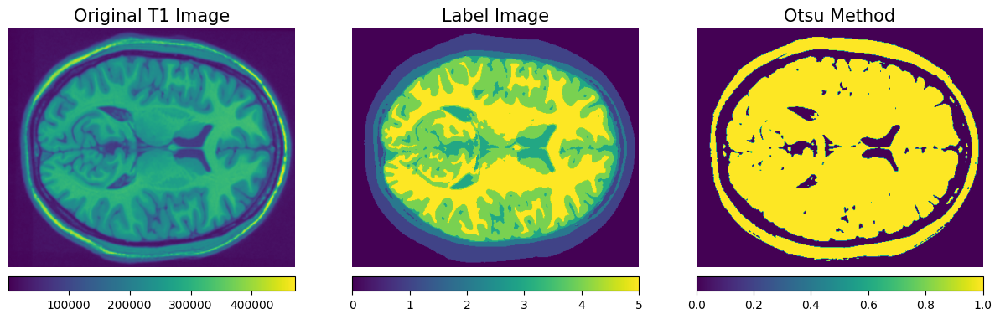

Level  8 Image
Dice coefficient: 0.6690554330547152
Jaccard index: 0.5026921854381182
Pixel accuracy: 0.5607938546868221


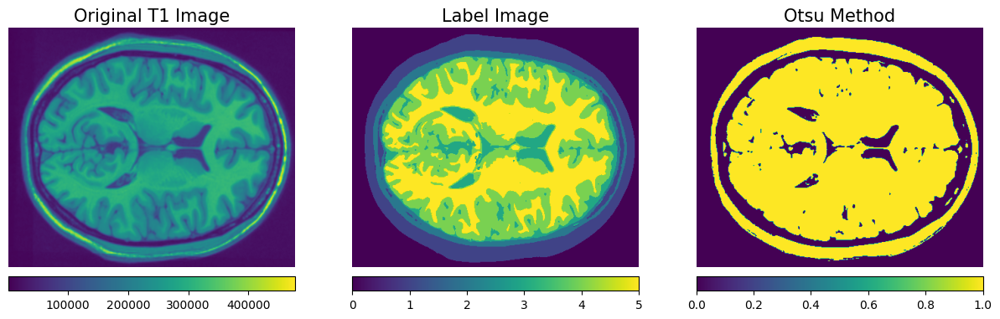

Level  9 Image
Dice coefficient: 0.6755509994874423
Jaccard index: 0.510061919504644
Pixel accuracy: 0.5665867853474837


In [8]:
process_images_otsu()

In [9]:
def adaptive_gaussian_segmentation(image):
    image = cv2.normalize(image, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)
    image = image.astype('uint8')
    thresholded_image = cv2.adaptiveThreshold(image, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 2)

    return thresholded_image

def process_images_adaptive_gaussian():
    for i in range(10):
        thresholded_image = adaptive_gaussian_segmentation(T1[:,:,i])
        show_compared_images(T1[:,:,0], label[:,:,0], thresholded_image, 'Adaptive Gaussian Thresholding')
        print('Level  '+ str(i) + ' Image')
        eval_matrix(thresholded_image, label[:,:,i])
        #print(evaluate_segmentation(segmented_image, label[:,:,i]))


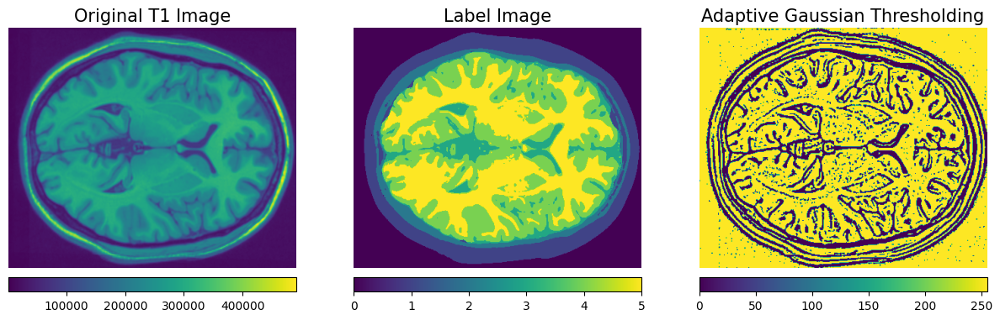

Level  0 Image
Dice coefficient: 0.019853268363456817
Jaccard index: 0.01002616020634419
Pixel accuracy: 0.013654907255224231


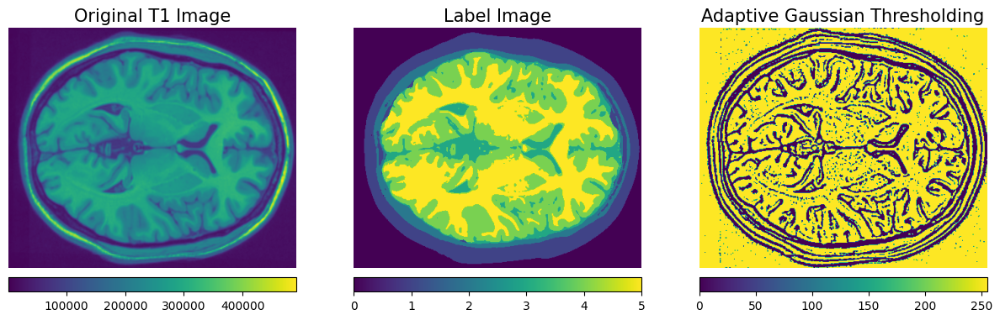

Level  1 Image
Dice coefficient: 0.019674712392789895
Jaccard index: 0.009935091227644969
Pixel accuracy: 0.013611224559489241


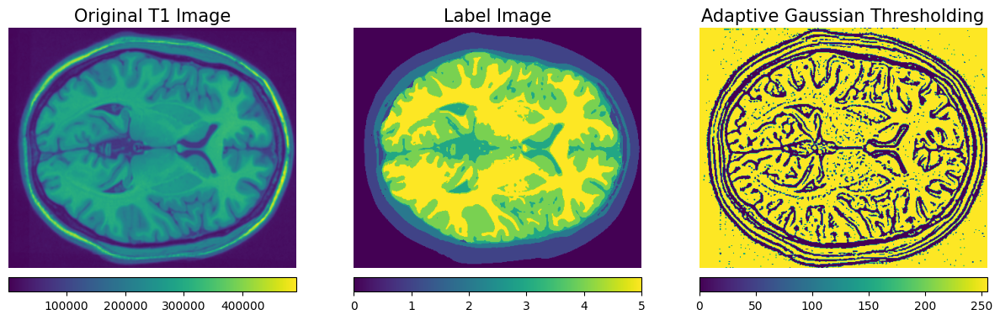

Level  2 Image
Dice coefficient: 0.01953351856143259
Jaccard index: 0.00986308970361562
Pixel accuracy: 0.013559306062845894


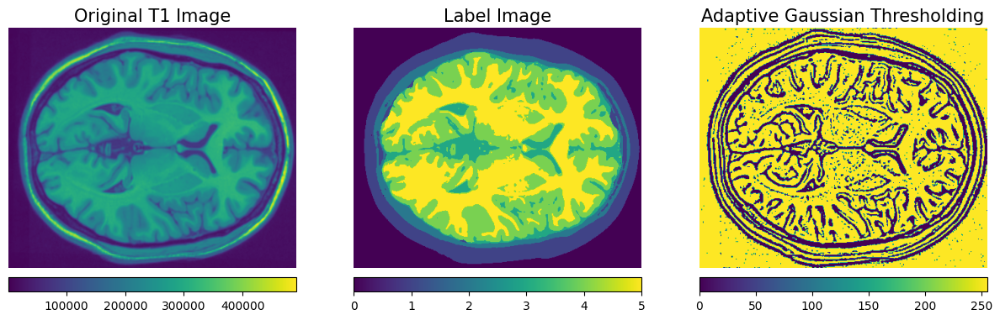

Level  3 Image
Dice coefficient: 0.019442115066791433
Jaccard index: 0.009816484140501196
Pixel accuracy: 0.01351762697836858


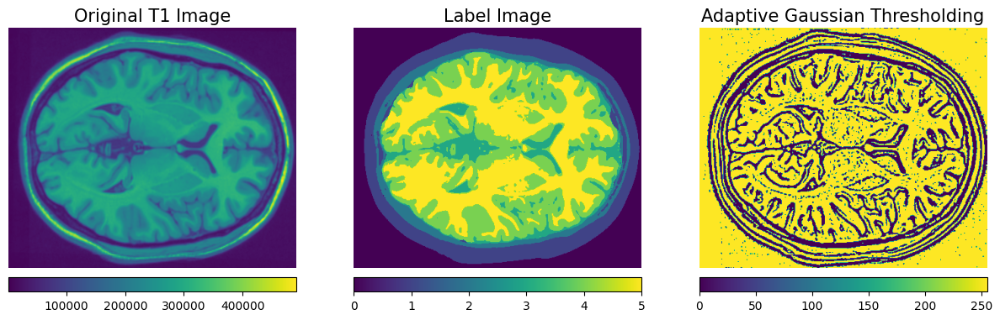

Level  4 Image
Dice coefficient: 0.019377051684071885
Jaccard index: 0.009783311710362482
Pixel accuracy: 0.013499042935444421


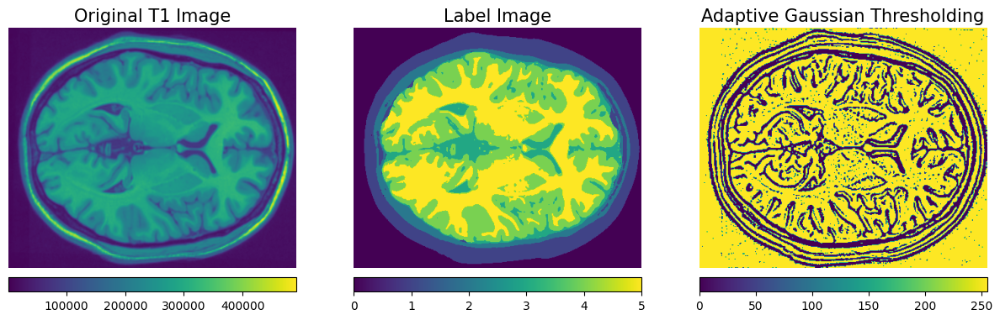

Level  5 Image
Dice coefficient: 0.019390126229568795
Jaccard index: 0.009789977565171054
Pixel accuracy: 0.013475434610328005


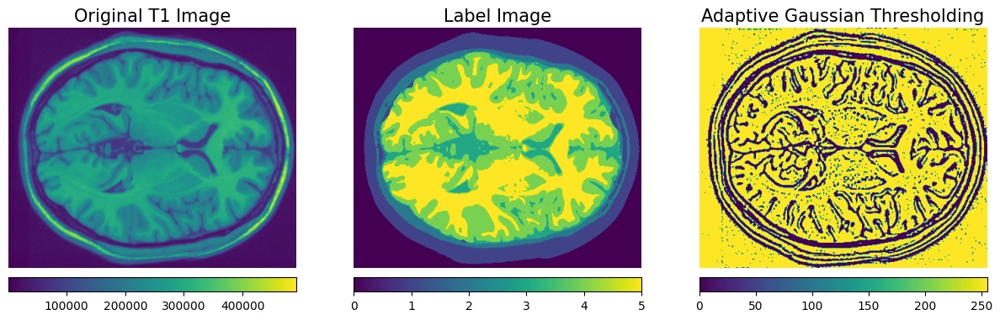

Level  6 Image
Dice coefficient: 0.01934159244827538
Jaccard index: 0.00976523381039912
Pixel accuracy: 0.013488076391312782


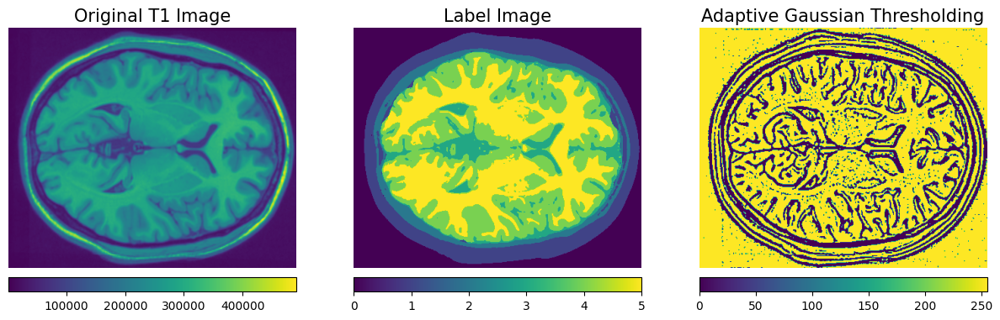

Level  7 Image
Dice coefficient: 0.01928288589635981
Jaccard index: 0.009735305339190824
Pixel accuracy: 0.01347008823369139


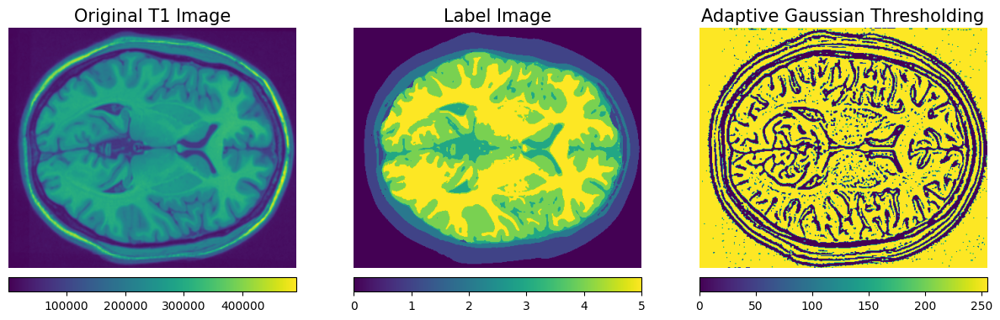

Level  8 Image
Dice coefficient: 0.01925959333116084
Jaccard index: 0.009723431332201252
Pixel accuracy: 0.013473340523203708


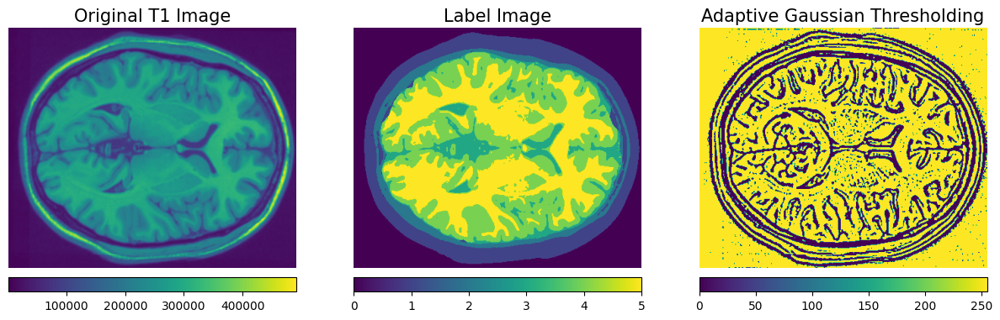

Level  9 Image
Dice coefficient: 0.019239360370923005
Jaccard index: 0.009713117267175615
Pixel accuracy: 0.01343923139733554


In [10]:
process_images_adaptive_gaussian()

In [11]:
def adaptive_mean_segmentation(image):
    image = cv2.normalize(image, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)
    image = image.astype('uint8')
    thresholded_image = cv2.adaptiveThreshold(image, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 11, 2)

    return thresholded_image

def process_images_adaptive_mean():
    for i in range(10):
        thresholded_image = adaptive_gaussian_segmentation(T1[:,:,i])
        show_compared_images(T1[:,:,0], label[:,:,0], thresholded_image, 'Adaptive Mean Thresholding')
        print('Level  '+ str(i) + ' Image')
        eval_matrix(thresholded_image, label[:,:,i])
        #print(evaluate_segmentation(segmented_image, label[:,:,i]))

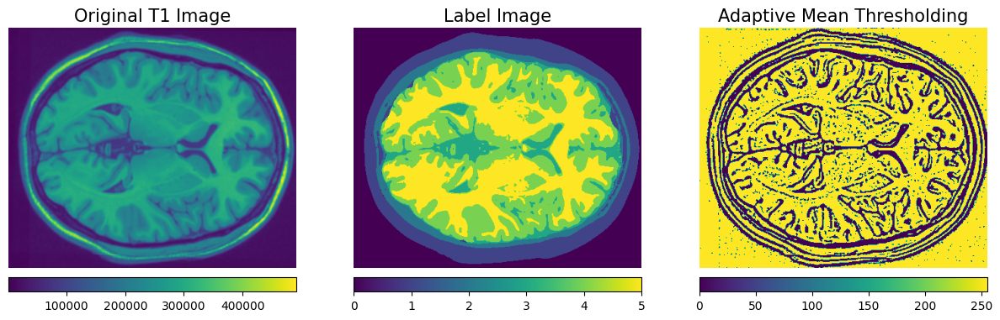

Level  0 Image
Dice coefficient: 0.019853268363456817
Jaccard index: 0.01002616020634419
Pixel accuracy: 0.013654907255224231


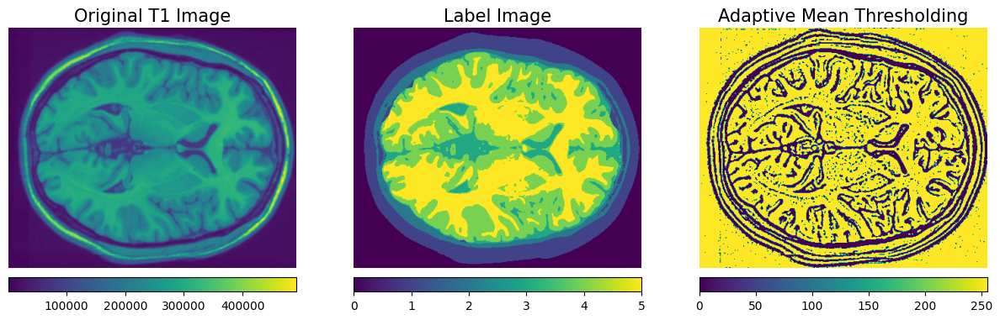

Level  1 Image
Dice coefficient: 0.019674712392789895
Jaccard index: 0.009935091227644969
Pixel accuracy: 0.013611224559489241


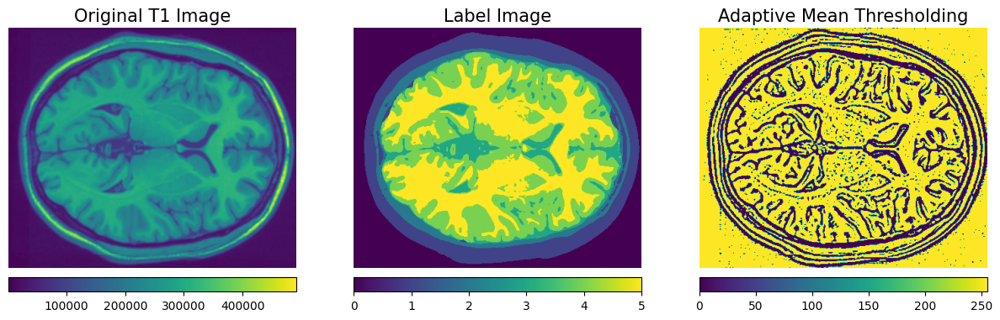

Level  2 Image
Dice coefficient: 0.01953351856143259
Jaccard index: 0.00986308970361562
Pixel accuracy: 0.013559306062845894


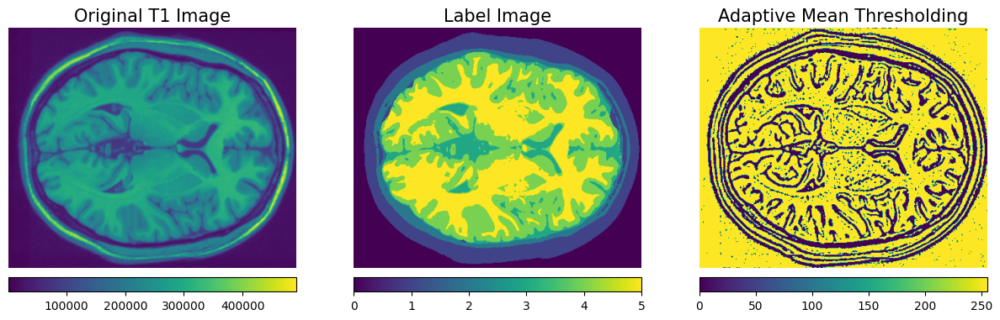

Level  3 Image
Dice coefficient: 0.019442115066791433
Jaccard index: 0.009816484140501196
Pixel accuracy: 0.01351762697836858


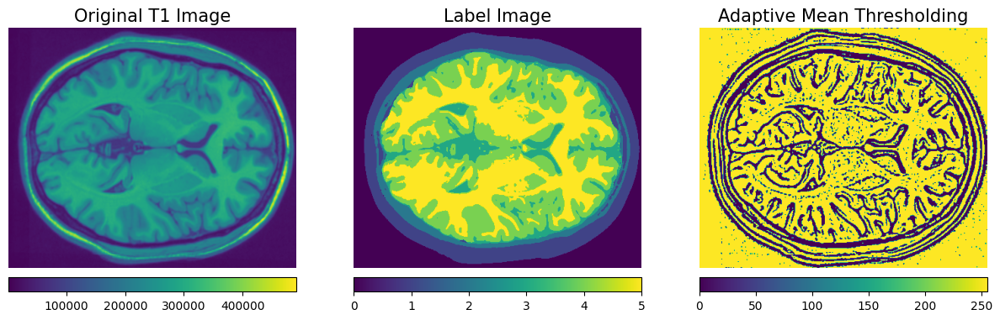

Level  4 Image
Dice coefficient: 0.019377051684071885
Jaccard index: 0.009783311710362482
Pixel accuracy: 0.013499042935444421


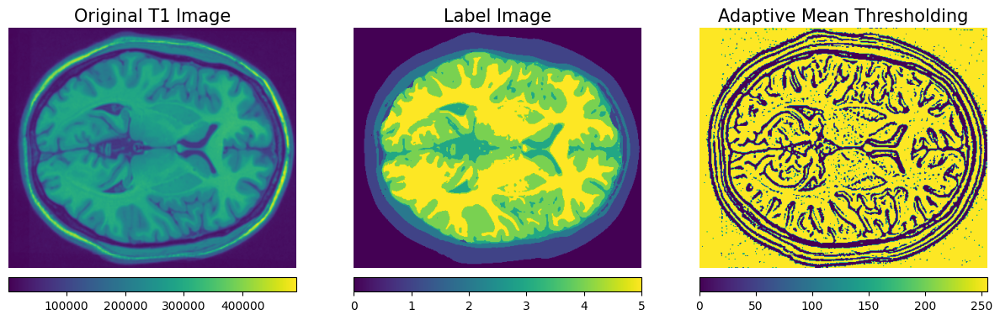

Level  5 Image
Dice coefficient: 0.019390126229568795
Jaccard index: 0.009789977565171054
Pixel accuracy: 0.013475434610328005


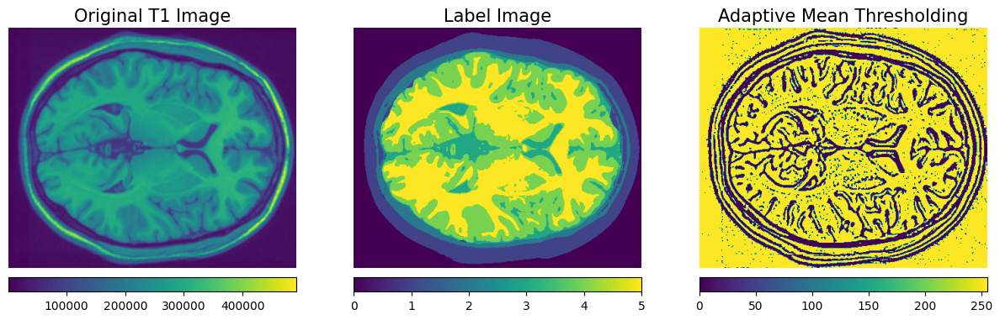

Level  6 Image
Dice coefficient: 0.01934159244827538
Jaccard index: 0.00976523381039912
Pixel accuracy: 0.013488076391312782


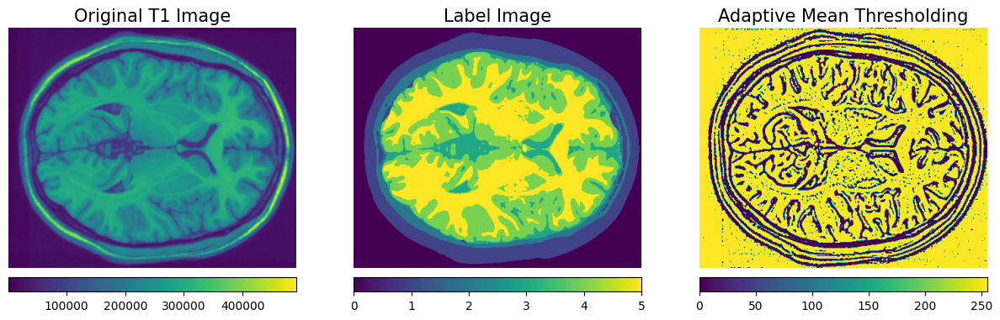

Level  7 Image
Dice coefficient: 0.01928288589635981
Jaccard index: 0.009735305339190824
Pixel accuracy: 0.01347008823369139


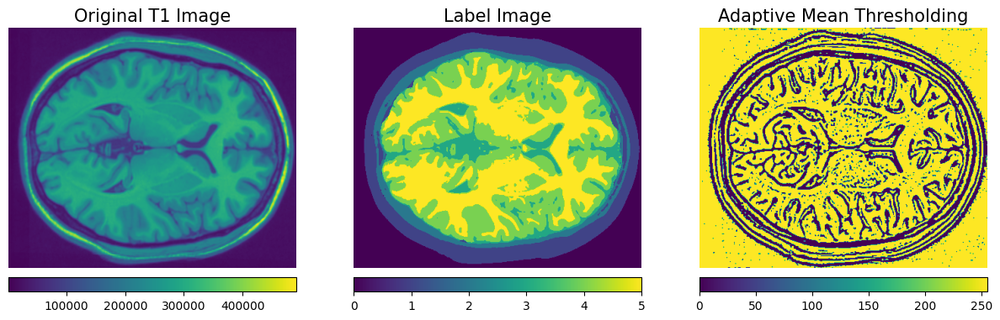

Level  8 Image
Dice coefficient: 0.01925959333116084
Jaccard index: 0.009723431332201252
Pixel accuracy: 0.013473340523203708


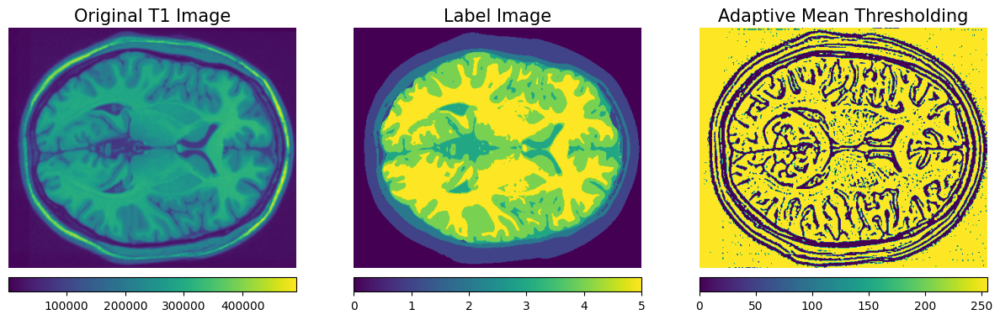

Level  9 Image
Dice coefficient: 0.019239360370923005
Jaccard index: 0.009713117267175615
Pixel accuracy: 0.01343923139733554


In [12]:

process_images_adaptive_mean()

In [13]:
def mean_shift_segmentation(image):
    image = cv2.normalize(image, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)
    image = image.astype('uint8')

    image = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)
    segmented_image = cv2.pyrMeanShiftFiltering(image, 10, 20)

    return segmented_image

def process_images_mean_shift_segmentation():
    for i in range(10):
        thresholded_image = adaptive_gaussian_segmentation(T1[:,:,i])
        show_compared_images(T1[:,:,0], label[:,:,0], thresholded_image, 'Mean Shift Thresholding')
        print('Level  '+ str(i) + ' Image')
        eval_matrix(thresholded_image, label[:,:,i])
        #print(evaluate_segmentation(segmented_image, label[:,:,i]))

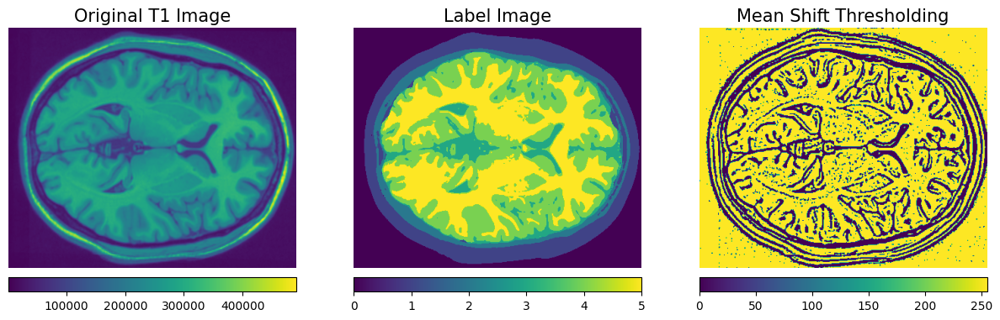

Level  0 Image
Dice coefficient: 0.019853268363456817
Jaccard index: 0.01002616020634419
Pixel accuracy: 0.013654907255224231


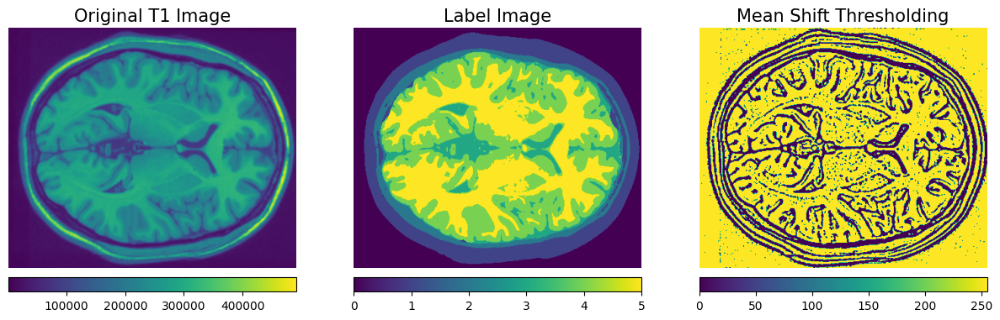

Level  1 Image
Dice coefficient: 0.019674712392789895
Jaccard index: 0.009935091227644969
Pixel accuracy: 0.013611224559489241


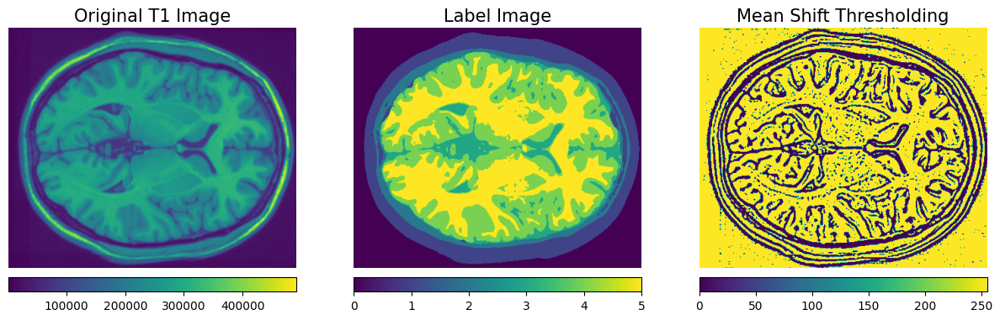

Level  2 Image
Dice coefficient: 0.01953351856143259
Jaccard index: 0.00986308970361562
Pixel accuracy: 0.013559306062845894


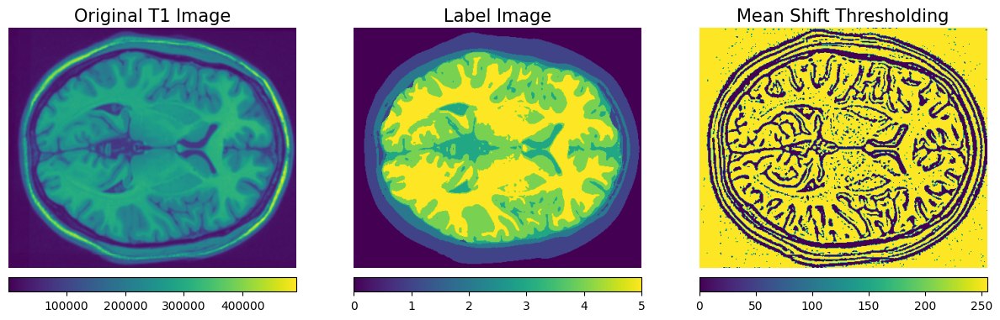

Level  3 Image
Dice coefficient: 0.019442115066791433
Jaccard index: 0.009816484140501196
Pixel accuracy: 0.01351762697836858


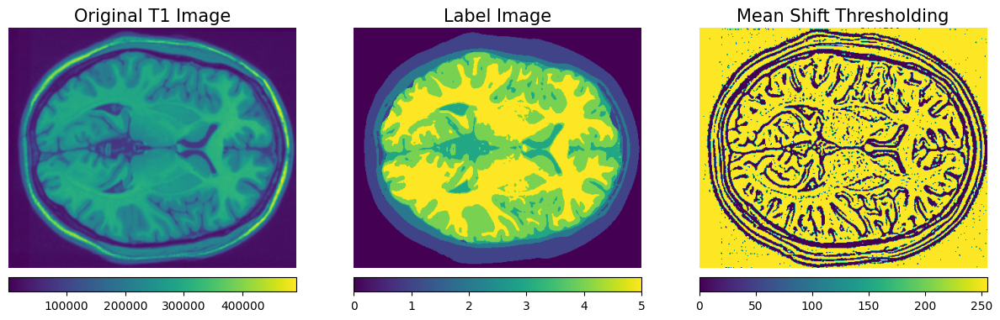

Level  4 Image
Dice coefficient: 0.019377051684071885
Jaccard index: 0.009783311710362482
Pixel accuracy: 0.013499042935444421


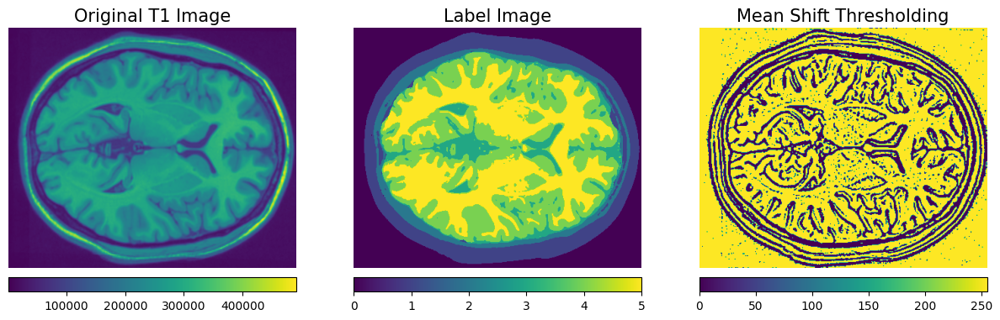

Level  5 Image
Dice coefficient: 0.019390126229568795
Jaccard index: 0.009789977565171054
Pixel accuracy: 0.013475434610328005


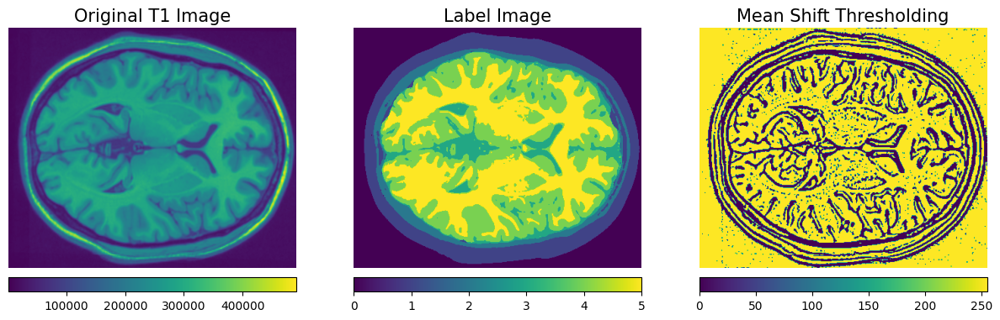

Level  6 Image
Dice coefficient: 0.01934159244827538
Jaccard index: 0.00976523381039912
Pixel accuracy: 0.013488076391312782


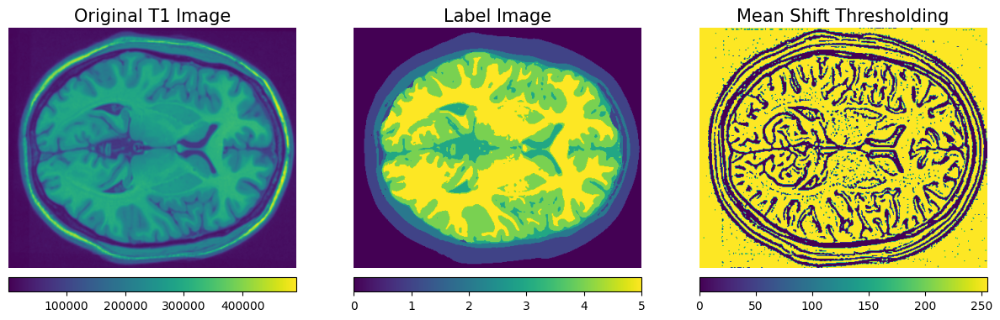

Level  7 Image
Dice coefficient: 0.01928288589635981
Jaccard index: 0.009735305339190824
Pixel accuracy: 0.01347008823369139


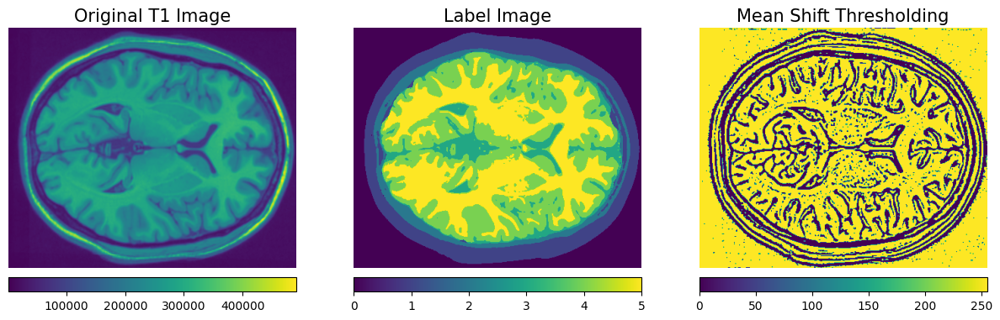

Level  8 Image
Dice coefficient: 0.01925959333116084
Jaccard index: 0.009723431332201252
Pixel accuracy: 0.013473340523203708


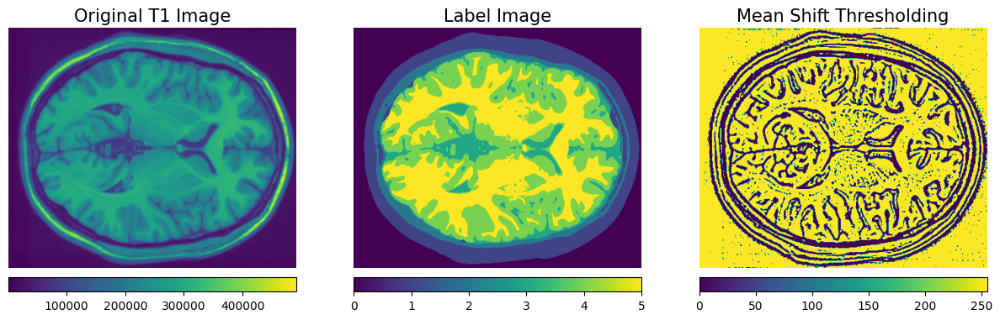

Level  9 Image
Dice coefficient: 0.019239360370923005
Jaccard index: 0.009713117267175615
Pixel accuracy: 0.01343923139733554


In [14]:
process_images_mean_shift_segmentation()

In [83]:


def region_growing(image, seed_point, threshold):
    image =  cv2.normalize(image, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)
    print('Minmax: ',np.min(image), np.max(image))
    # Create a mask and initialize it with zeros
    mask = np.zeros_like(image, dtype=np.uint8)

    # Define the region growing criteria
    connectivity = 4  # 4-connected neighborhood
    new_value = 255   # Set the intensity value for the segmented region

    # Create a list to store the seed points
    seed_points = [seed_point]

    # Iterate over the seed points until the list is empty
    while seed_points:
        # Pop the first seed point from the list
        current_point = seed_points.pop(0)

        # Check if the current point is within the image bounds
        if (0 <= current_point[0] < image.shape[0]) and (0 <= current_point[1] < image.shape[1]):
            # Check if the current pixel is not already segmented
            if mask[current_point] == 0:
                # Check the intensity difference between the current pixel and the seed pixel
                if abs(int(image[current_point]) - int(image[seed_point])) < threshold:
                    # Add the current pixel to the segmented region
                    mask[current_point] = new_value

                    # Add the neighboring pixels to the seed points list
                    seed_points.append((current_point[0] + 1, current_point[1]))
                    seed_points.append((current_point[0] - 1, current_point[1]))
                    seed_points.append((current_point[0], current_point[1] + 1))
                    seed_points.append((current_point[0], current_point[1] - 1))

    return mask

def process_images_region_growing(s1, s2, thresh):
    seed_point = (s1, s2)
    threshold = thresh
    for i in range(10):
        # Perform region growing segmentation
        segmented_image = region_growing(T1[:,:,i], seed_point, threshold)
        show_compared_images(T1[:,:,i], label[:,:,i], segmented_image, 'Region Growing Segmentation')
        print('Level  '+ str(i) + ' Image')
        eval_matrix(segmented_image, label[:,:,i])
        #print(evaluate_segmentation(segmented_image, label[:,:,i]))




# Section

In [ ]:
#seed , seed, threshold
process_images_region_growing(100, 100, 50)

In [ ]:
#seed , seed, threshold
process_images_region_growing(50, 50, 50)

In [ ]:
#seed , seed, threshold
process_images_region_growing(50, 50, 100)

In [ ]:
#seed , seed, threshold
process_images_region_growing(10, 10, 50)

In [ ]:
#seed , seed, threshold
process_images_region_growing(150, 150, 50)

In [ ]:
segmented_image1 = region_growing(T1[:,:,0], (100, 100), 50)
segmented_image2 = kmeans_segmentation(T1[:,:,0], 5)

# show_compared_images(label[:,:,0], segmented_image1, segmented_image2, 'Region + K-Mean')

# plt.imshow(join_segmentations(segmented_image1, segmented_image2))
show_compared_images(segmented_image1, segmented_image2, join_segmentations(segmented_image1, segmented_image2),'Region + K-Mean')
show_compared_images(segmented_image1, segmented_image2, join_segmentations(segmented_image2, segmented_image1),'Region + K-Mean')

In [ ]:
segmented_image1 = region_growing(T1[:,:,0], (50, 50), 50)
segmented_image2 = kmeans_segmentation(T1[:,:,0], 5)

show_compared_images(segmented_image1, segmented_image2, join_segmentations(segmented_image1, segmented_image2),'Region + K-Mean')
show_compared_images(segmented_image1, segmented_image2, join_segmentations(segmented_image2, segmented_image1),'Region + K-Mean')
# plt.imshow(join_segmentations(segmented_image1, segmented_image2))


# plt.imshow(join_segmentations(segmented_image2, segmented_image1))

In [ ]:

segmented_image1 = region_growing(T1[:,:,0], (150, 150), 50)
segmented_image2 = kmeans_segmentation(T1[:,:,0], 5)
show_compared_images(segmented_image1, segmented_image2, join_segmentations(segmented_image1, segmented_image2),'Region + K-Mean')
show_compared_images(segmented_image1, segmented_image2, join_segmentations(segmented_image2, segmented_image1),'Region + K-Mean')

In [ ]:
segmented_image1 = region_growing(T1[:,:,0], (70, 70), 100)
segmented_image2 = kmeans_segmentation(T1[:,:,0], 5)
show_compared_images(segmented_image1, segmented_image2, join_segmentations(segmented_image1, segmented_image2),'Region + K-Mean')
show_compared_images(segmented_image1, segmented_image2, join_segmentations(segmented_image2, segmented_image1),'Region + K-Mean')

In [ ]:
segmented_image1 = region_growing(T1[:,:,0], (70, 70), 90)
segmented_image2 = kmeans_segmentation(T1[:,:,0], 5)
show_compared_images(segmented_image1, segmented_image2, join_segmentations(segmented_image1, segmented_image2),'Region + K-Mean')
show_compared_images(segmented_image1, segmented_image2, join_segmentations(segmented_image2, segmented_image1),'Region + K-Mean')

In [ ]:
segmented_image2 = kmeans_segmentation(T1[:,:,0], 5)
segmented_image1 = region_growing(segmented_image2, (80, 80), 70)

plt.imshow(segmented_image2)
show_compared_images(segmented_image1, segmented_image2, join_segmentations(segmented_image1, segmented_image2),'Region + K-Mean')
show_compared_images(segmented_image1, segmented_image2, join_segmentations(segmented_image2, segmented_image1),'Region + K-Mean')

In [ ]:
segmented_image2 = kmeans_segmentation(T1[:,:,0], 5)
segmented_image1 = region_growing(segmented_image2, (50, 50), 70)

plt.imshow(segmented_image2)
show_compared_images(segmented_image1, segmented_image2, join_segmentations(segmented_image1, segmented_image2),'Region + K-Mean')
show_compared_images(segmented_image1, segmented_image2, join_segmentations(segmented_image2, segmented_image1),'Region + K-Mean')

In [ ]:
segmented_image1 = region_growing(T1[:,:,0], (50, 50), 70)
segmented_image2 = region_growing(T1[:,:,0], (70, 70), 100)
segmented_image3 = region_growing(T1[:,:,0], (100, 100), 50)
segmented_image5 = region_growing(T1[:,:,0], (120, 120), 30)
segmented_image6 = region_growing(T1[:,:,0], (150, 150), 20)
segmented_image4 = kmeans_segmentation(T1[:,:,0], 5)

plt.imshow(segmented_image4)
show_compared_images(segmented_image1, segmented_image2, segmented_image3,'Region + K-Mean')
plt.imshow(segmented_image5)
show_compared_images(segmented_image1, segmented_image2, segmented_image3,'Region + K-Mean')
plt.imshow(segmented_image6)

In [ ]:
show_compared_images(T1[:,:,0], label[:,:,0], join_segmentations(segmented_image1, segmented_image2),'Region + K-Mean')
show_compared_images(T1[:,:,0], label[:,:,0], join_segmentations(segmented_image2, segmented_image1),'Region + K-Mean')

In [ ]:
join1 = join_segmentations(segmented_image1, segmented_image2)
show_compared_images(T1[:,:,0], label[:,:,0], join_segmentations(segmented_image3, join1),'Region + K-Mean')
show_compared_images(T1[:,:,0], label[:,:,0], join_segmentations(join1, segmented_image3),'Region + K-Mean')

In [ ]:
join2 = join_segmentations(join1, segmented_image3)

show_compared_images(T1[:,:,0], label[:,:,0], join_segmentations(segmented_image4, join2),'Region + K-Mean')
show_compared_images(T1[:,:,0], label[:,:,0], join_segmentations(join2, segmented_image4),'Region + K-Mean')

In [ ]:


show_compared_images(T1[:,:,0], label[:,:,0], join_segmentations(segmented_image4, segmented_image3),'Region + K-Mean')
show_compared_images(T1[:,:,0], label[:,:,0], join_segmentations(segmented_image3, segmented_image4),'Region + K-Mean')

In [ ]:
join1_1 = join_segmentations(segmented_image3, segmented_image4)

show_compared_images(T1[:,:,0], label[:,:,0], join_segmentations(join1_1, segmented_image2),'Region + K-Mean')
show_compared_images(T1[:,:,0], label[:,:,0], join_segmentations(segmented_image2, join1_1),'Region + K-Mean')

In [ ]:
join1_2 = join_segmentations(join1_1, segmented_image3)

show_compared_images(T1[:,:,0], label[:,:,0], join_segmentations(join1_2, segmented_image1),'Region + K-Mean')
show_compared_images(T1[:,:,0], label[:,:,0], join_segmentations(segmented_image1, join1_2),'Region + K-Mean')

In [ ]:
plt.imshow(join1_2[:,:]==2)

In [ ]:
plt.imshow(join1_2[:,:]==1)

In [ ]:
plt.imshow(join1_2[:,:]==0)

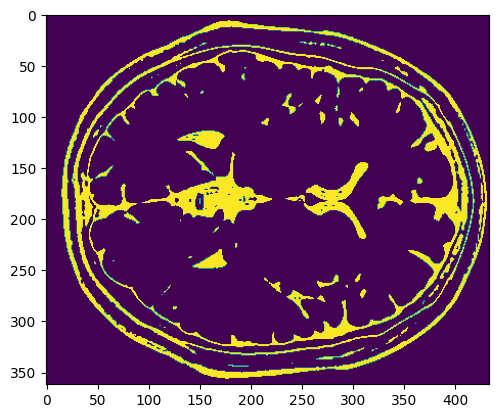

In [80]:
plt.imshow(join1_2[:,:]==3)

In [ ]:
plt.imshow(join1_2[:,:]==4)

In [ ]:
plt.imshow(join1_2[:,:]==6)

#Section 2

Minmax:  -5.2359432e-09 255.0
Minmax:  -5.2359432e-09 255.0
Minmax:  -5.2359432e-09 255.0
Minmax:  -5.2359432e-09 255.0
Minmax:  -5.2359432e-09 255.0
Minmax:  -5.2359432e-09 255.0


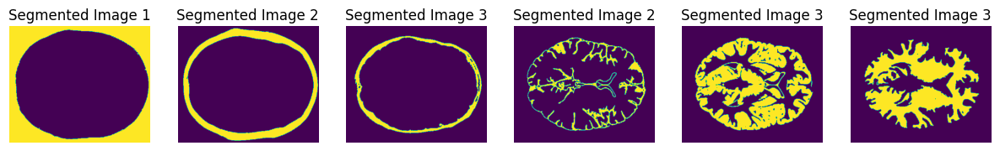

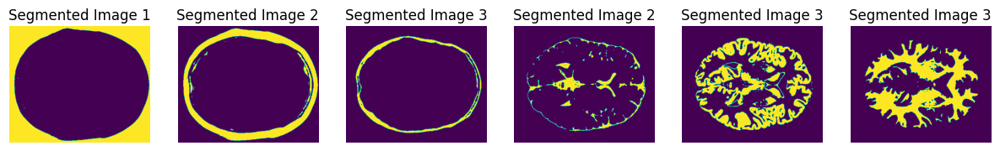

In [93]:

segmented_image1 = region_growing(T1[:,:,0], (50, 50), 70) #Air
segmented_image2 = region_growing(T1[:,:,0], (70, 70), 150) #Skin / Skull
segmented_image3 = region_growing(T1[:,:,0], (80, 80), 33) #bone
#segmented_image4 = region_growing(T1[:,:,0], (180, 180), 60) # CSF
segmented_image4 = region_growing(T1[:,:,0], (180, 250), 27)
segmented_image5 = region_growing(T1[:,:,0], (160, 160), 35) # Grey Matter
segmented_image6 = region_growing(T1[:,:,0], (120, 120), 30) #White matter
segmented_image7 = kmeans_segmentation(T1[:,:,0], 5)

# Create subplots
fig, axes = plt.subplots(1, 6, figsize=(15, 5))

# Display segmented images
axes[0].imshow(segmented_image1)
axes[0].set_title('Segmented Image 1')
axes[0].axis('off')

axes[1].imshow(segmented_image2)
axes[1].set_title('Segmented Image 2')
axes[1].axis('off')

axes[2].imshow(segmented_image3)
axes[2].set_title('Segmented Image 3')
axes[2].axis('off')

axes[3].imshow(segmented_image4)
axes[3].set_title('Segmented Image 2')
axes[3].axis('off')

axes[4].imshow(segmented_image5)
axes[4].set_title('Segmented Image 3')
axes[4].axis('off')

axes[5].imshow(segmented_image6)
axes[5].set_title('Segmented Image 3')
axes[5].axis('off')

# Show the plot
plt.show()

fig, axes = plt.subplots(1, 6, figsize=(15, 5))

# Display segmented images
axes[0].imshow(label[:,:,0]==0)
axes[0].set_title('Segmented Image 1')
axes[0].axis('off')

axes[1].imshow(label[:,:,0]==1)
axes[1].set_title('Segmented Image 2')
axes[1].axis('off')

axes[2].imshow(label[:,:,0]==2)
axes[2].set_title('Segmented Image 3')
axes[2].axis('off')

axes[3].imshow(label[:,:,0]==3)
axes[3].set_title('Segmented Image 2')
axes[3].axis('off')

axes[4].imshow(label[:,:,0]==4)
axes[4].set_title('Segmented Image 3')
axes[4].axis('off')

axes[5].imshow(label[:,:,0]==5)
axes[5].set_title('Segmented Image 3')
axes[5].axis('off')
plt.show()

In [52]:
li = [
segmented_image1,
segmented_image2,
segmented_image3,
segmented_image4,
segmented_image5,
segmented_image6]
j = 0
for i in li:
  print('-----------------------')
  eval_matrix(i, label[:,:,0]==j)
  print('-----------------------')
  j += 1


-----------------------
Dice coefficient: 0.9599178985724499
Jaccard index: 0.9229251202909156
Pixel accuracy: 0.9229370815412584
-----------------------
-----------------------
Dice coefficient: 0.957166641440896
Jaccard index: 0.9178519593613933
Pixel accuracy: 0.923959772762168
-----------------------
-----------------------
Dice coefficient: 0.8677768764613256
Jaccard index: 0.7664362778152394
Pixel accuracy: 0.7664362778152394
-----------------------
-----------------------
Dice coefficient: 0.46255708996567846
Jaccard index: 0.30086131130251365
Pixel accuracy: 0.3298399326032013
-----------------------
-----------------------
Dice coefficient: 0.8548980425995731
Jaccard index: 0.746569366225113
Pixel accuracy: 0.7476203641534026
-----------------------
-----------------------
Dice coefficient: 0.8753284522564351
Jaccard index: 0.7782969650229098
Pixel accuracy: 0.7800729040097205
-----------------------


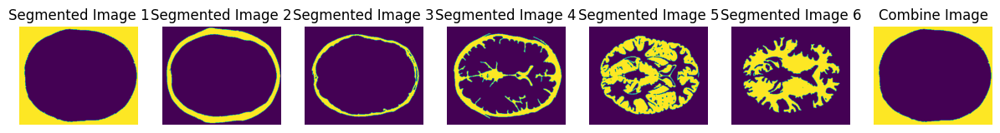

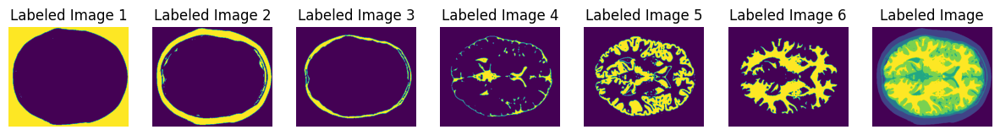

-----------------------
Dice coefficient: 0.9599178985724499
Jaccard index: 0.9229251202909156
Pixel accuracy: 0.9229370815412584
-----------------------
-----------------------
Dice coefficient: 0.957166641440896
Jaccard index: 0.9178519593613933
Pixel accuracy: 0.923959772762168
-----------------------
-----------------------
Dice coefficient: 0.8677768764613256
Jaccard index: 0.7664362778152394
Pixel accuracy: 0.7664362778152394
-----------------------
-----------------------
Dice coefficient: 0.46255708996567846
Jaccard index: 0.30086131130251365
Pixel accuracy: 0.3298399326032013
-----------------------
-----------------------
Dice coefficient: 0.8548980425995731
Jaccard index: 0.746569366225113
Pixel accuracy: 0.7476203641534026
-----------------------
-----------------------
Dice coefficient: 0.8753284522564351
Jaccard index: 0.7782969650229098
Pixel accuracy: 0.7800729040097205
-----------------------


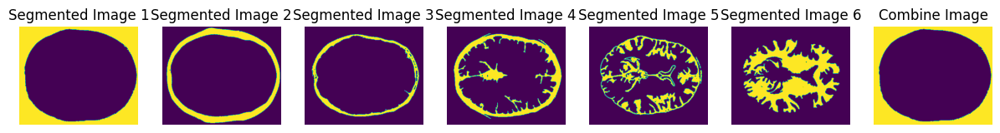

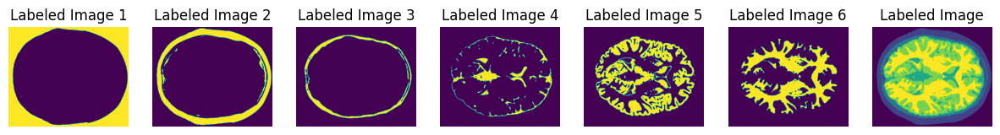

-----------------------
Dice coefficient: 0.9553023261151468
Jaccard index: 0.9144294564787556
Pixel accuracy: 0.91444261394838
-----------------------
-----------------------
Dice coefficient: 0.950799054578572
Jaccard index: 0.9062125408175918
Pixel accuracy: 0.9138572513287775
-----------------------
-----------------------
Dice coefficient: 0.8680164263203133
Jaccard index: 0.7668100902725048
Pixel accuracy: 0.7668887576958758
-----------------------
-----------------------
Dice coefficient: 0.4024788924581403
Jaccard index: 0.2519396398320165
Pixel accuracy: 0.3177199987015938
-----------------------
-----------------------
Dice coefficient: 0.559040590405904
Jaccard index: 0.3879641485275288
Pixel accuracy: 0.5730850741749924
-----------------------
-----------------------
Dice coefficient: 0.8731926996918701
Jaccard index: 0.7749263777871266
Pixel accuracy: 0.782608695652174
-----------------------


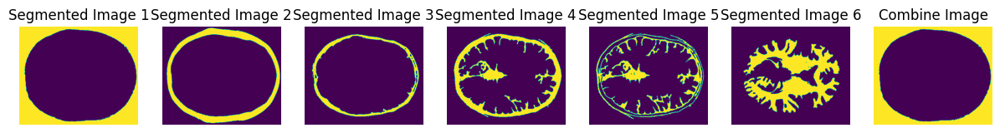

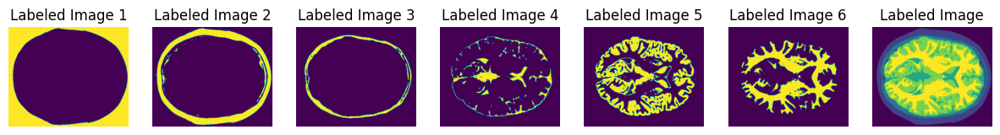

-----------------------
Dice coefficient: 0.9526675974456982
Jaccard index: 0.9096134093839463
Pixel accuracy: 0.9096272341913211
-----------------------
-----------------------
Dice coefficient: 0.9436955485241212
Jaccard index: 0.8933935166187936
Pixel accuracy: 0.9025835239416551
-----------------------
-----------------------
Dice coefficient: 0.8630419161676647
Jaccard index: 0.7590798011291817
Pixel accuracy: 0.7607931726907631
-----------------------
-----------------------
Dice coefficient: 0.3642792033809353
Jaccard index: 0.2227025566550711
Pixel accuracy: 0.2983873426211017
-----------------------
-----------------------
Dice coefficient: 0.2888362652232747
Jaccard index: 0.1687952235973271
Pixel accuracy: 0.47380541162924583
-----------------------
-----------------------
Dice coefficient: 0.8055005589451426
Jaccard index: 0.6743415118167058
Pixel accuracy: 0.7059398480930176
-----------------------


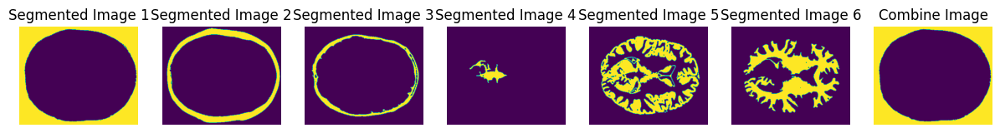

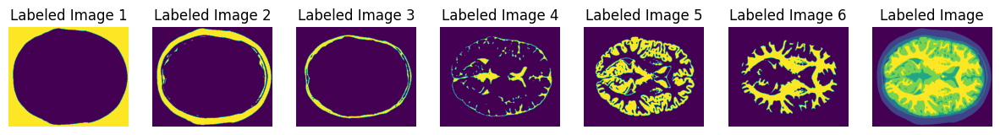

-----------------------
Dice coefficient: 0.9500039942027001
Jaccard index: 0.9047691505086515
Pixel accuracy: 0.9047836386950947
-----------------------
-----------------------
Dice coefficient: 0.921341314167464
Jaccard index: 0.8541546332205627
Pixel accuracy: 0.8719481272187206
-----------------------
-----------------------
Dice coefficient: 0.8511417284902206
Jaccard index: 0.7408587722240859
Pixel accuracy: 0.7463678896823442
-----------------------
-----------------------
Dice coefficient: 0.3148759695875893
Jaccard index: 0.18685625740588824
Pixel accuracy: 0.5231706665241328
-----------------------
-----------------------
Dice coefficient: 0.7135213521352135
Jaccard index: 0.5546313211800832
Pixel accuracy: 0.6229308585908447
-----------------------
-----------------------
Dice coefficient: 0.7544768758422361
Jaccard index: 0.6057509982822852
Pixel accuracy: 0.6623488278787184
-----------------------


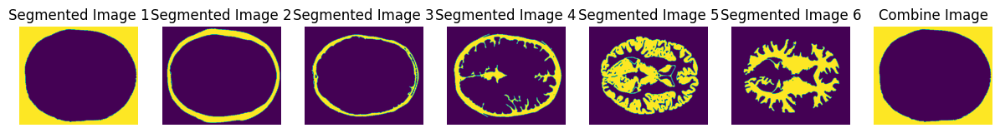

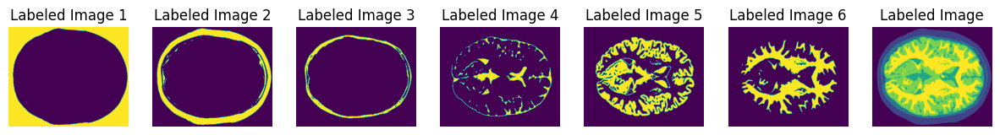

-----------------------
Dice coefficient: 0.947258224189529
Jaccard index: 0.8998011154827273
Pixel accuracy: 0.8998162758024425
-----------------------
-----------------------
Dice coefficient: 0.9041671372106155
Jaccard index: 0.8250958407189084
Pixel accuracy: 0.8501448046902592
-----------------------
-----------------------
Dice coefficient: 0.8347151003977572
Jaccard index: 0.7163184734331305
Pixel accuracy: 0.7250039866050072
-----------------------
-----------------------
Dice coefficient: 0.32089969676450675
Jaccard index: 0.19111407230774627
Pixel accuracy: 0.2979150814183534
-----------------------
-----------------------
Dice coefficient: 0.6867268237304401
Jaccard index: 0.5229123963996078
Pixel accuracy: 0.5858104448742747
-----------------------
-----------------------
Dice coefficient: 0.7187210444066437
Jaccard index: 0.5609403333045505
Pixel accuracy: 0.630247059465159
-----------------------


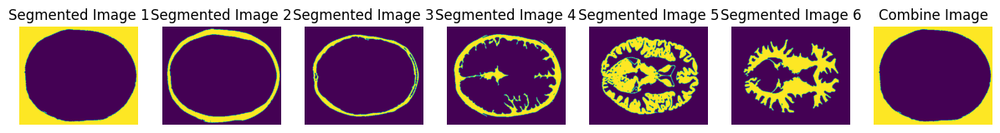

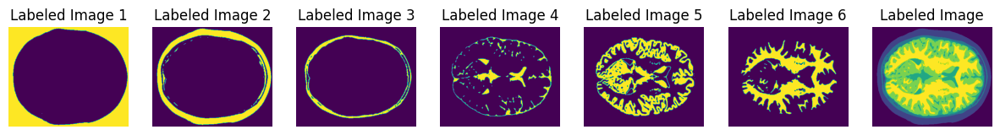

-----------------------
Dice coefficient: 0.9437893973062446
Jaccard index: 0.8935617526459286
Pixel accuracy: 0.8935777453421482
-----------------------
-----------------------
Dice coefficient: 0.8780905243194487
Jaccard index: 0.7826750226766719
Pixel accuracy: 0.82035989366778
-----------------------
-----------------------
Dice coefficient: 0.8241984508285126
Jaccard index: 0.7009673115410273
Pixel accuracy: 0.7171701238268002
-----------------------
-----------------------
Dice coefficient: 0.30594619828441383
Jaccard index: 0.18060004822431194
Pixel accuracy: 0.29151775077436265
-----------------------
-----------------------
Dice coefficient: 0.6659443927599892
Jaccard index: 0.49918788178383533
Pixel accuracy: 0.5716572291430728
-----------------------
-----------------------
Dice coefficient: 0.6915780396665708
Jaccard index: 0.5285588752196837
Pixel accuracy: 0.6176596351197263
-----------------------


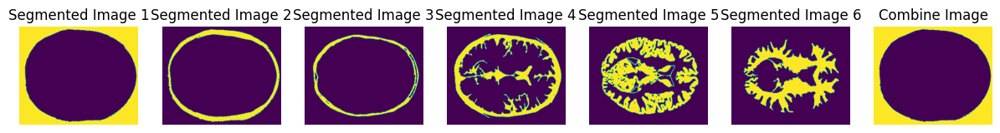

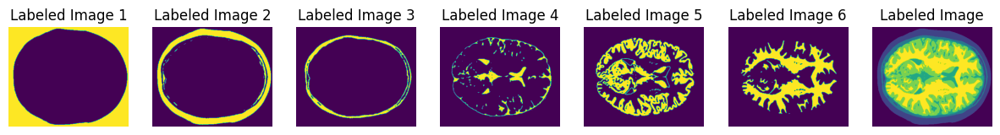

-----------------------
Dice coefficient: 0.9447962773805471
Jaccard index: 0.8953685976724676
Pixel accuracy: 0.8953843506689035
-----------------------
-----------------------
Dice coefficient: 0.8134612082709902
Jaccard index: 0.6855748956050771
Pixel accuracy: 0.7599128677863367
-----------------------
-----------------------
Dice coefficient: 0.8009776536312849
Jaccard index: 0.668025626092021
Pixel accuracy: 0.695024077046549
-----------------------
-----------------------
Dice coefficient: 0.3232283367455169
Jaccard index: 0.1927682485510018
Pixel accuracy: 0.2629415715245131
-----------------------
-----------------------
Dice coefficient: 0.6408513296019601
Jaccard index: 0.47150936726758574
Pixel accuracy: 0.5587072018890201
-----------------------
-----------------------
Dice coefficient: 0.6685893848736602
Jaccard index: 0.5021661817006143
Pixel accuracy: 0.6001558036873539
-----------------------


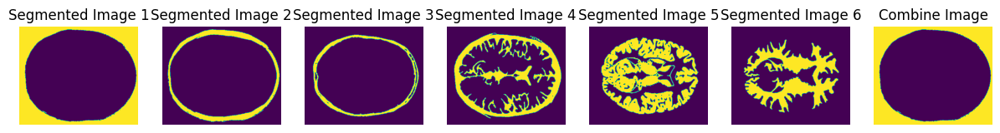

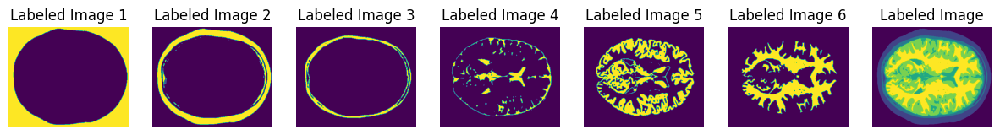

-----------------------
Dice coefficient: 0.9401547235868767
Jaccard index: 0.8870678999190146
Pixel accuracy: 0.8870847450403802
-----------------------
-----------------------
Dice coefficient: 0.8151350823196053
Jaccard index: 0.6879561291386632
Pixel accuracy: 0.7608015424002023
-----------------------
-----------------------
Dice coefficient: 0.7726096930060032
Jaccard index: 0.6294735167806585
Pixel accuracy: 0.6612129144851658
-----------------------
-----------------------
Dice coefficient: 0.2957749586321015
Jaccard index: 0.17355393299155922
Pixel accuracy: 0.23468482508931354
-----------------------
-----------------------
Dice coefficient: 0.6307277016604664
Jaccard index: 0.46062985603763895
Pixel accuracy: 0.5376334923880937
-----------------------
-----------------------
Dice coefficient: 0.6473770677543621
Jaccard index: 0.4786086738005989
Pixel accuracy: 0.5820098714031494
-----------------------


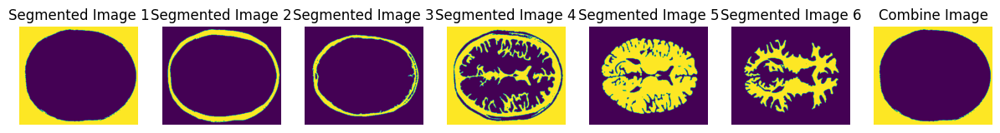

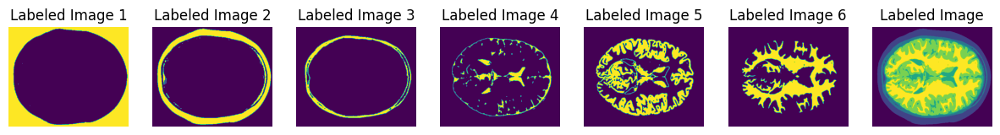

-----------------------
Dice coefficient: 0.9350961538461539
Jaccard index: 0.8781038374717833
Pixel accuracy: 0.8781218359770503
-----------------------
-----------------------
Dice coefficient: 0.8348991368210215
Jaccard index: 0.7165895788138021
Pixel accuracy: 0.7766091305049202
-----------------------
-----------------------
Dice coefficient: 0.7332658134610073
Jaccard index: 0.5788632068614624
Pixel accuracy: 0.6108013703231007
-----------------------
-----------------------
Dice coefficient: 0.13520553520553522
Jaccard index: 0.07250425596926972
Pixel accuracy: 0.10327073222198777
-----------------------
-----------------------
Dice coefficient: 0.5657334295229719
Jaccard index: 0.3944409227461897
Pixel accuracy: 0.4628060781653036
-----------------------
-----------------------
Dice coefficient: 0.649276342676757
Jaccard index: 0.4806877699643178
Pixel accuracy: 0.5821173704978592
-----------------------


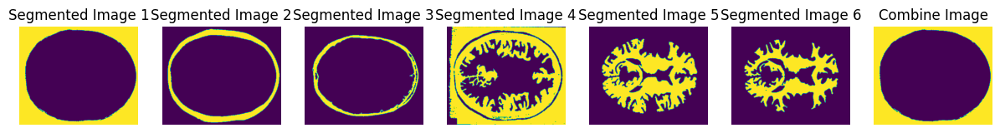

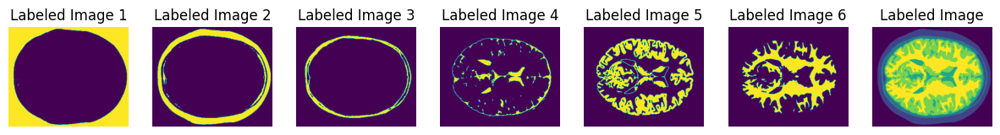

-----------------------
Dice coefficient: 0.9315801253357207
Jaccard index: 0.8719232461193623
Pixel accuracy: 0.8719420241286864
-----------------------
-----------------------
Dice coefficient: 0.8509050711620837
Jaccard index: 0.7405002405002405
Pixel accuracy: 0.7880504174169258
-----------------------
-----------------------
Dice coefficient: 0.7094750438232309
Jaccard index: 0.5497569345152988
Pixel accuracy: 0.5907998180754986
-----------------------
-----------------------
Dice coefficient: 0.1138923411527109
Jaccard index: 0.06038485693988283
Pixel accuracy: 0.09686293913904008
-----------------------
-----------------------
Dice coefficient: 0.4465994640806431
Jaccard index: 0.28749794644323967
Pixel accuracy: 0.442447262315199
-----------------------
-----------------------
Dice coefficient: 0.6447762882515979
Jaccard index: 0.47577110897783714
Pixel accuracy: 0.5798487990901184
-----------------------


In [72]:
for i in range(10):
  segmented_image1 = region_growing(T1[:,:,i], (50, 50), 70)
  segmented_image2 = region_growing(T1[:,:,i], (70, 70), 150)
  segmented_image3 = region_growing(T1[:,:,i], (80, 80), 33)
  segmented_image4 = region_growing(T1[:,:,i], (180, 180), 60)
  segmented_image5 = region_growing(T1[:,:,i], (160, 160), 35)
  segmented_image6 = region_growing(T1[:,:,i], (120, 120), 30)
  #segmented_image7 = kmeans_segmentation(T1[:,:,0], 5)

  # Create subplots
  fig, axes = plt.subplots(1, 7, figsize=(15, 5))

  # Display segmented images
  axes[0].imshow(segmented_image1)
  axes[0].set_title('Segmented Image 1')
  axes[0].axis('off')

  axes[1].imshow(segmented_image2)
  axes[1].set_title('Segmented Image 2')
  axes[1].axis('off')

  axes[2].imshow(segmented_image3)
  axes[2].set_title('Segmented Image 3')
  axes[2].axis('off')

  axes[3].imshow(segmented_image4)
  axes[3].set_title('Segmented Image 4')
  axes[3].axis('off')

  axes[4].imshow(segmented_image5)
  axes[4].set_title('Segmented Image 5')
  axes[4].axis('off')

  axes[5].imshow(segmented_image6)
  axes[5].set_title('Segmented Image 6')
  axes[5].axis('off')

  axes[6].imshow(segmented_image1)
  # axes[6].imshow(combine_images([segmented_image1, segmented_image2, segmented_image3, segmented_image4, segmented_image5, segmented_image6]))
  axes[6].set_title('Combine Image')
  axes[6].axis('off')

  # Show the plot
  plt.show()

  fig, axes = plt.subplots(1, 7, figsize=(15, 5))

  # Display segmented images
  axes[0].imshow(label[:,:,i]==0)
  axes[0].set_title('Labeled Image 1')
  axes[0].axis('off')

  axes[1].imshow(label[:,:,i]==1)
  axes[1].set_title('Labeled Image 2')
  axes[1].axis('off')

  axes[2].imshow(label[:,:,i]==2)
  axes[2].set_title('Labeled Image 3')
  axes[2].axis('off')

  axes[3].imshow(label[:,:,i]==3)
  axes[3].set_title('Labeled Image 4')
  axes[3].axis('off')

  axes[4].imshow(label[:,:,i]==4)
  axes[4].set_title('Labeled Image 5')
  axes[4].axis('off')

  axes[5].imshow(label[:,:,i]==5)
  axes[5].set_title('Labeled Image 6')
  axes[5].axis('off')

  axes[6].imshow(label[:,:,i])
  axes[6].set_title('Labeled Image')
  axes[6].axis('off')
  plt.show()

  li = [
  segmented_image1,
  segmented_image2,
  segmented_image3,
  segmented_image4,
  segmented_image5,
  segmented_image6]
  j = 0
  for i in li:
    print('-----------------------')
    eval_matrix(i, label[:,:,0]==j)
    print('-----------------------')
    j += 1

In [68]:
def combine_images(img_array):
  combined_image = np.zeros_like(segmented_image1)
  img_array[0][(img_array[0] == 255) ]=0
  img_array[1][(img_array[1] == 255) ]=40
  img_array[2][(img_array[2] == 255) ]=80
  img_array[3][(img_array[3] == 255) ]=120
  img_array[4][(img_array[4] == 255) ]=160
  img_array[5][(img_array[5] == 255) ]=200
  # print(np.unique(segmented_image6))
  # plt.imshow(segmented_image6)
  #Merge the region growing images
  combined_image = np.maximum(combined_image, img_array[0])
  combined_image = np.maximum(combined_image, img_array[1])
  combined_image = np.maximum(combined_image, img_array[2])
  combined_image = np.maximum(combined_image, img_array[3])
  combined_image = np.maximum(combined_image, img_array[4])
  combined_image = np.maximum(combined_image, img_array[5])

  return combined_image

  # show_compared_images(T1[:,:,9], label[:,:,9], combined_image, 'Combined image 9th')

In [55]:
print(np.unique(segmented_image1))

[  0 255]
